I strongly Suggest to hide the code to read through this Notebook. To do so: Press the button below !

In [106]:
from IPython.display import HTML

HTML(
'''
<script>
    code_show = false; // Code cells will be hidden by default

    function code_toggle() {
        if (code_show) {
            document.querySelectorAll('.jp-CodeCell .jp-InputArea').forEach(function(el) {
                el.style.display = 'none';
            });
        } else {
            document.querySelectorAll('.jp-CodeCell .jp-InputArea').forEach(function(el) {
                el.style.display = 'block';
            });
        }
        code_show = !code_show;
    }

    // Hide code cells when the page is loaded
    document.addEventListener("DOMContentLoaded", function() {
        document.querySelectorAll('.jp-CodeCell .jp-InputArea').forEach(function(el) {
            el.style.display = 'none';
        });
    });
</script>
<form action="javascript:code_toggle()">
    <input type="submit" value="Show / Hide code">
</form>
'''
)


<h1><u> Noise Prediction </u></h>



## 1. Introduction: 

The task at hand is as follows: the central street of Naamsestraat in Leuven is located right next to the city's festive square. One can easily imagine that individuals heading to or coming back from the area could potentially cause noise nuisances to the street's inhabitants. In an attempt to mitigate the hindrance to the residents, we leverage the data science tools at our disposal. Let's jump right in!

We have a collection of datasets: 
- Hourly noise data collected in Naamsestraat, Leuven during 2022 (From March on)
- Detected events based on noise over the same period.eg: Cars, screams, laughs 
- 2002 quaterly weather records from multiple weather stations for every 10 minute interval 
- A collection of all infrastructure work in the city of Leuven for 2022



That being said, let's illustrate this setting. 

In [3]:



import pandas as pd 
import numpy as np
import os
import random
import glob
import re
import pickle


from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, AdaBoostClassifier
from sklearn.preprocessing import StandardScaler, OneHotEncoder, QuantileTransformer
from sklearn.compose import ColumnTransformer, TransformedTargetRegressor,make_column_transformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate,GridSearchCV
from sklearn.metrics import mean_squared_error, explained_variance_score, r2_score, recall_score,precision_recall_fscore_support, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPRegressor, MLPClassifier


import tensorflow as tf
from tensorflow import keras 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import MeanSquaredError, MeanSquaredLogarithmicError
from tensorflow.keras.optimizers import Adam

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import geopandas as gpd
from shapely.geometry import Point, Polygon
import calplot 
import folium
import streamlit as st

import plotly.express as px 
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output
import plotly.io as pio
pio.renderers.default = "notebook_connected"

import pyproj
from pyproj import CRS,Transformer
from shapely.ops import transform
from shapely import geometry, Point, LineString,wkt
import geopandas as gpd


from time import time 

import datetime


from streamlit_folium import st_folium
from  utils import (noiseprocessing, groupdata, meteoprocessing, groupmeteo, double_lineplot, mapoutliers,longitude,latitude,
                    weather_sound_map, read_data, noisecat, school_calendar, time_of_day,min00,event_type_freq,get_coord,inbound,
                    residuals_by,plot_predictions,Preprocess_to_sequence,Validation_Loss_Accuracy, plot_class_proba, True_False_positive,
                    residuals_by,plot_predictions,Validation_Loss_Accuracy,plot_class_proba,True_False_positive)


import warnings
# warnings.filterwarnings("ignore", category=FutureWarning, module="pandas")
# warnings.filterwarnings("ignore", category=FutureWarning, module="Matplotlib")
# warnings.filterwarnings("ignore", category=UserWarning, module="Matplotlib")
warnings.filterwarnings('ignore')
random.seed(36)


#########################################

dir_data_folder="C:/Users/terli/Programs/Python/Projects/Latvia_Noise_in_leuven/Data/"



dirmeteo=os.path.join(dir_data_folder, "Meteo/*.csv")
dirclass=os.path.join(dir_data_folder, "Classified_events/*.csv")
dirpercent=os.path.join(dir_data_folder, "Percentiled_data/*.csv")
direvent=os.path.join(dir_data_folder, "Events/*.csv")


LSTM_checkpoint=os.path.join(dir_data_folder, "Models/LSTM_checkpoint.ckpt")
History_LSTM_file=os.path.join(dir_data_folder, "Models/History_LSTM.pkl")

MLP_file_sav=os.path.join(dir_data_folder, "Models/MLP_regr_model.sav")
MLP_classifier_file=os.path.join(dir_data_folder, "Models/MLP_class_model.sav")

Weather_Metadata=os.path.join(dir_data_folder, "01_Metadata_v2.csv")
Sound_weather_file=os.path.join(dir_data_folder, "Sound_weather.csv")

The map below shows, in red, the different microphones installed on Naamsestraat from which our data orifinates, and in blue the weather stations the weather was observed from.

In [4]:


Sound= noiseprocessing(read_data(dirpercent,';'))
hourly_sound=groupdata(Sound,'Hour')
daily_sound=groupdata(Sound,'Date')
Base_Meteo=meteoprocessing(read_data(dirmeteo,','))
Meteo=groupmeteo(Base_Meteo,'Hour')
daily_weather=groupmeteo(Base_Meteo,'Date')
Sound_Weather_day= pd.merge(daily_weather,daily_sound,on='Date',how='outer')


Micro_loc=pd.DataFrame(data=zip(Sound['Location'].unique(),latitude,longitude),columns=['Loc','LAT','LON'])
map=weather_sound_map(Micro_loc,pd.read_csv(Weather_Metadata),width=1000,height=500)
display(map)

The noise is encoded as LAF, for different percentiles over an hour. For example, a LAF99 value of 40.9 dB(A) means that during 99% of that hour the noise level was 40.9 db(A). These measures ranges from 0.005 to 99.5 to of an hour. 

The behaviour of such an encoding is illustrated below, as one can imagine, the longer the interval the lower the average measured noise level. Which begs the question, which variable is the most relevant with respect to noise disturbances.


In [5]:
plots=(Sound.drop(Sound.filter(regex='unit').columns,axis=1).drop(['id','Vacation','Time_of_Day'],axis=1)).melt(id_vars=['Date_time','Date', 'Time','Location'])
boxfig=px.box(plots,x='variable',y='value',color='variable',color_discrete_sequence=px.colors.qualitative.T10)
boxfig.show()

The prvious plot also showcases the sheer amount of outliers in the dataset. Remember that there are several microphones in the street, what if some locations in the street were more susceptible to outliers, i.e, louder noise levels than average ? And what about the distribution of outliers throughout the year? 

Let's have a look for the lAF005 value, in other words the maximal level of noise for 1.8 consecutive seconds for the given hour. 

In [6]:
mapoutliers(Sound,'laf005_per_hour')

1038


It does seems like some locations are exposed to more disturbances than others, on top of that, the number of outliers seems to differ throughout the year. The figure below, showing the average noise level (LAF25) per day,  further emphasizes that.

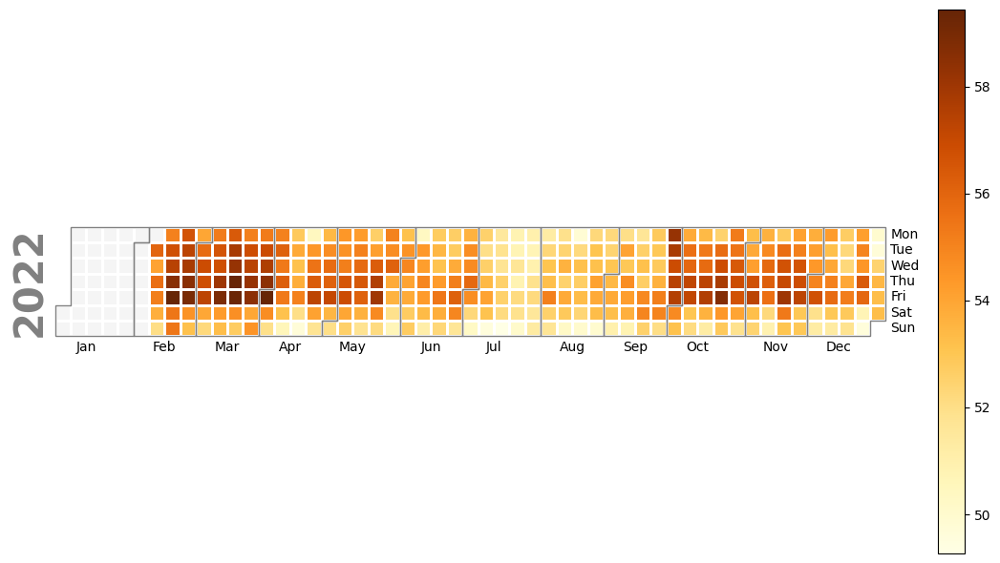

In [7]:
fig_df=pd.concat([(pd.DataFrame(index=range(38),columns=daily_sound.columns)),daily_sound],ignore_index=True)

missing_day=pd.DataFrame({'Date':pd.date_range(start='2022-01-01',end='2022-02-07')})
fig_df['Date']=fig_df['Date'].fillna(missing_day['Date'])
fig_df['Date']=pd.to_datetime(fig_df['Date'],format='%Y-%m-%d %H:%M:%S')
Sound_calendar=pd.Series(fig_df.set_index('Date')['avg_laf25_per_hour'])
Calendarmap=calplot.calplot(Sound_calendar,dropzero='True',cmap='YlOrBr',figsize=(12,6), yearlabel_kws={'fontname':'sans-serif'})
Calendarmap[0].show()

One could be tempted to think that there is a relationship between the weather and the amount of noise. The warmer it is, the more people tend to go outside right?

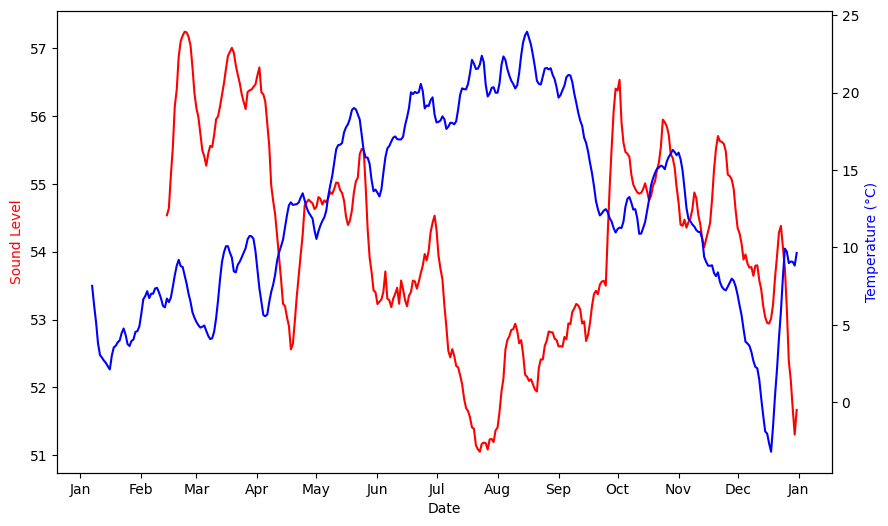

In [8]:
double_lineplot(Sound_Weather_day,'avg_laf25_per_hour','avg_LC_TEMP_QCL3','Date','Date','Sound Level','Temperature (°C)')

Well... no, that's not it. In fact, what we are observing here is probably a symptom of Belgian university calendar and Belgian students' habits. Leuven is a university city, and the vast majority of its student only live there during the semesters outside of exam periods. Hence, the noise levels are low during the summer for example. 

In [9]:
##We import the Dataset 
Noise_class_perhour=noiseprocessing(read_data(dirclass,';'))

##All the hours are changed into round hours
Noise_class_perhour['Date_time']= noiseprocessing(read_data(dirclass,';'))['Date_time'].apply(lambda a: min00(a))
#Classifications with less than 50% certainty are being discarded
Noise_class_perhour=Noise_class_perhour.loc[(Noise_class_perhour['Certainty']>=50)]
#We create a column 'Count', equal to one. This will make the computation of our event classifications easier. 
Noise_class_perhour.loc[:,'count']=1

pivot=pd.pivot_table(Noise_class_perhour,values='count', index=['Date_time','Location'],columns='Class',aggfunc='count')
#The dataset is filled with missing values for the hours in which no events were detected, we want those to be equal to 0 instead and get rid of the double index set above. 
pivot=pivot.fillna(0).reset_index(level=['Date_time','Location'])


#For the sake of readability and use we rename the columns
pivot.rename(columns={'Human voice - Shouting':'Shouting','Human voice - Singing':'Singing','Music non-amplified':'Music','Nature elements - Wind':'Wind','Transport road - Passenger car':'Car','Transport road - Siren':'Siren'},inplace=True)
#Create a list of the detected noise, just in case. 
detected_noise=['Shouting', 'Singing', 'Music', 'Wind', 'Car','Siren']

#One again we read the data 
Events=read_data(direvent,',')

#Rename several columns
Events.rename(columns={'Einde':'End','Soort':'Sort','Categorie':'Category','Locatie':'Location','Id':'id'},inplace=True)

#We remove those evetns who start on different periods. And we  convert the start and end date columns into pandas datetime foramt 
Events=Events[Events['Start']!='meerdere periodes']
for i in ['Start','End']:
    Events[str(i)]=pd.to_datetime(Events[str(i)],format='%d-%m-%Y %H:%M')

#We drop duplicate events
Events=Events.sort_values('End',ascending=True).drop_duplicates(subset='id',keep='last')

lambert_crs=CRS.from_proj4("+proj=lcc +lat_0=90 +lon_0=4.36748666666667 +lat_1=51.1666672333333 +lat_2=49.8333339 +x_0=150000.013 +y_0=5400088.438 +ellps=intl +towgs84=-106.8686,52.2978,-103.7239,0.3366,-0.457,1.8422,-1.2747 +units=m +no_defs +type=crs")
crs_4326=CRS.from_epsg(4326)

Events['geometry']=gpd.GeoSeries.from_wkt(Events['Location']).set_crs(lambert_crs)

# Events_geo=gpd.GeoDataFrame(Events,geometry='geometry').set_crs(lambert_crs).to_crs(crs_4326)
# convex_hull=gpd.GeoDataFrame(gpd.read_file(r"C:\Users\terli\Programs\Python\Projects\Latvia_Noise_in_leuven\Convex_hull.shp").to_crs(crs_4326),geometry='geometry')
# Relevent_Events_id=(gpd.sjoin(convex_hull,Events_geo,predicate='contains')['id_right']).to_list()
# Events=(Events[Events['id'].isin(Relevent_Events_id)])


In [10]:
Events_geo=gpd.GeoDataFrame(Events,geometry='geometry').set_crs(lambert_crs).to_crs(crs_4326)
convex_hull=gpd.GeoDataFrame(gpd.read_file(r"C:\Users\terli\Programs\Python\Projects\Latvia_Noise_in_leuven\Convex_hull.shp").to_crs(crs_4326),geometry='geometry')
Relevent_Events_id=(gpd.sjoin(convex_hull,Events_geo,predicate='contains')['id_right']).to_list()
Events=(Events[Events['id'].isin(Relevent_Events_id)])

While the student population might have an impact on sound levels, construction works, or other events,happening around Naamsestraat could have an impact. On the map below, 50, amongst the almost 400 of those instances in the area are displayed.

In [15]:
for index,row in (Events_geo[Events_geo['id'].isin(Relevent_Events_id)]).sample(n=50).iterrows():
    point=row['geometry']
    x, y = point.x, point.y
    info=row['Sort']
    # print(x,y)
    # print(info)
    folium.CircleMarker(radius=3,fill=True,fill_color='orange',location=[y,x],popup=info,color='orange').add_to(map)

display(map)

In [ ]:

Events=Events.drop(['Location','geometry','Category'],axis=1)


## 2. The Prediction Model: 
### 1. The Simple MLP :

Now the data on hand and the context has been outline let's think of a way to fight noise nuisance for the inhabitants of Naamsestraat. One approach would be to construct a model capable to predict the maximal noise level of the following hour. As a result the nearby police could be able to patrol the area to deter potentially loud behaviours for example. Of course, this would only make sense at night, but we will come back to that later. 
For the time being, let's build a simple neural network and see if we can predict the noise level of an hour. 

Of course, we are tackling a real life problem, requiring real life solution. We need to be mindful of our model's design and ensure that if deployed, the training data would also be available during the time of predictions. Therefore, in this scenario, we shift all the data by one hour, and try to predict the noise at t, given the information at t-1.

In [66]:


#We create a dataset with hours throughout the year 2022.
start_date = datetime.datetime(2022, 1, 1)
end_date = datetime.datetime(2022, 12, 31, 23, 59)
date_range = pd.date_range(start=start_date, end=end_date, freq='H')
Year_events=pd.DataFrame()
Year_events['Date_time']=date_range

# Year_events['Events_info']= ''
Year_events['Event_type']=''



#If a given hour lays between the start and end date of an event, such event will be added in a list which will fill the empty value of the Year_events Dataframe. 
for index, row in Year_events.iterrows(): 
    current_hour=row['Date_time']
    matching_events= Events[(current_hour>=(Events['Start'])) & (current_hour <= (Events['End']))]
  
    event_type_list=matching_events['Sort'].tolist()
    
    Year_events.at[index, 'Event_type'] = event_type_list



#We create a new column for each type of events. The value in that column is the amount of time that event appears in the list. 
#Hence, the amount of that type of event happening around Naamsestraat At that given hour. 
Sort_list=list(Events['Sort'].unique())
for sort in Sort_list:
        Year_events[f'{sort}']=Year_events['Event_type'].apply(lambda x: event_type_freq(f'{sort}',x))
        

Year_events.fillna(0,inplace=True)

Sound_weather= pd.merge(Sound,pivot,on=['Date_time','Location'],how='left').fillna(0).merge((Year_events.drop('Event_type',axis=1)),on=['Date_time'],how='left').merge(Meteo,on=['Date_time'],how='left')

#To that we make some adjustements, essentially minor feature engeneering such as:

#Extracting the month of the year
Sound_weather['Month'] = Sound_weather['Date_time'].apply(lambda w: w.strftime('%B'))

#The day of the week
Sound_weather['Day_of_week'] = Sound_weather['Date_time'].apply(lambda w: w.strftime('%A'))

#And the hour of the day 
Sound_weather['Hour']=Sound_weather['Date_time'].dt.hour.astype(str)


#One specific date and time appears twice, we therefore delete the duplicates 
Sound_weather=Sound_weather.drop_duplicates(['Date_time','Location'],keep='last')

#Sort the dataframe for upcoming manipulations
Sound_weather=Sound_weather.sort_values(['Location','Date_time'])

#And create an index from one to 50320, sorted by Location and Date_time
Sound_weather.reset_index(drop=True, inplace=True)


#The approach we are taking to do so is creating a column upon which we will index our cummulative sum. 
#Therefore, for every location, every sequence of 12:00 get assigned a index. 
Sound_weather['ind']=''

#In the loop below, n is the index. n is 0, until either one of those two conditions are met: 
#Either, it is 12:00 or if the Location in a row is different than the previous one. 

# (Remember, we sorted the dataset by Location, and Time. Meaning if we itterate through the rows, Location will change. 
# If the  sum was to go on, one location's detected sources of noise on Naamsestraat would carry on being summed on another on the count of another one. Which, we want to avoid)
n=0
for index, i in Sound_weather.iterrows():
    if index==0: 
        Sound_weather.loc[index, "ind"]=n
    else :
        if str(i['Time'])=='12:00:00' or i['Location']!= Sound_weather.loc[(index-1),'Location']:
            n+=1
            Sound_weather.loc[index, "ind"] = n
        else:
            Sound_weather.loc[index, "ind"]=n


#First we need to shift all our counts of noise by one row down, (for the reason explain above). 
#We then apply the cummulative sum of the shifted count of noise source on our index above. 
for source in detected_noise: 
    Sound_weather[f'shifted_{source}']=Sound_weather.sort_values(['ind','Date_time'])[[f'{source}']].shift(periods=1)
    Sound_weather.loc[0,f'shifted_{source}']=0 #---> Since we shift our column, the first instance is 0, and we loose the last one. 
    Sound_weather[f'cum_{source}']=Sound_weather.sort_values(['ind','Date_time']).groupby(['ind'])[f'shifted_{source}'].cumsum()
 

#We transform the dataset to have our percentile variables as single instances, we transform columns into rows essentially. 
Individual_Record=Sound_weather.melt(id_vars=(Sound_weather.filter(regex=r'^(?!laf)').columns)).drop(
             ['Date_time','Date','Time','id','shifted_Siren', 'shifted_Car','shifted_Singing','ind','Shouting', 'Singing', 'Music',
            'Wind', 'Car', 'Siren','shifted_Shouting','shifted_Wind','shifted_Music'],axis=1)

#We compute the variable, 'Sound duration' which essentially the amount of time a percentile would correspond to in minutes. The 25th percentile corresponding to 15 minutes. 
Individual_Record['Sound_duration']=(Individual_Record['variable'].apply(lambda a: (
    float(re.findall('\d+',a)[0])/1000) if a in ['laf005_per_hour','laf995_per_hour'] else (float(re.findall('\d+',a)[0])/100)))*60

#This is WHO's recomendation for maximal time of exposure for a given sound level. unfortunately, given the nature of the data, very little amount of observations fit that category. 
#Source: https://www.engineeringtoolbox.com/noise-exposure-level-duration-d_717.html
Individual_Record['max_time_of_exposure']=(480/(2**((Individual_Record['value']-85)/3)))

#Here we drop the final variables we won't need
training_set=(Individual_Record[Individual_Record.filter(regex=r'^(?!value)').columns]).drop(['variable','max_time_of_exposure'],axis=1)


#We define our numerical columns and categoricals ones for later on in our model. 
numeric_cols=training_set[training_set.filter(regex=r'^(?!value)').columns].select_dtypes(include=['float','int']).columns
categorical_cols=training_set[training_set.filter(regex=r'^(?!value)').columns].select_dtypes(include=['object']).columns

# print(' Our model will have the following numerical input variables :' )
# print(*numeric_cols)
# print('')
# print('And categorical variables: ' )
# print(*categorical_cols)

In [68]:
y=pd.DataFrame(Individual_Record['value'])
#Train and test split
X_train,X_test,y_train,y_test= train_test_split(training_set,y,test_size=0.15,shuffle=True)

#Sklearn MLP_predictor

numeric_transformer=Pipeline([("scaler",StandardScaler())])
Categorical_transformer=Pipeline([("Dummy_encoder",OneHotEncoder())])
preprocessor= ColumnTransformer([('numeric_preprocessing',numeric_transformer,numeric_cols),
                                    ('categorical_preprocessing',Categorical_transformer,categorical_cols)])
MLP_predictor= MLPRegressor( 
    activation='relu',
    random_state=36,
    hidden_layer_sizes=(80,30,10),
    learning_rate='invscaling',
    learning_rate_init=0.01,
    max_iter=100,
    early_stopping=True) 


We stat by fitting a simple Multilayer Perceptron Model. In this case, we keep the model generic and try to predict the noise level for every noise duration, or LAF values. 

In [ ]:
MLP_pipeline=pickle.load(open(MLP_file_sav, 'rb'))
MLP_pipeline

TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                           regressor=Pipeline(steps=[('all_column_preprocessing',
                                                      ColumnTransformer(transformers=[('numeric_preprocessing',
                                                                                       Pipeline(steps=[('scaler',
                                                                                                        StandardScaler())]),
                                                                                       Index(['Evenement', 'Werk', 'Grondwerk', 'avg_LC_HUMIDITY', 'avg_LC_RAD',
       'avg_LC_RAININ', 'avg_LC_DAILYRAIN', 'avg_LC_WINDDIR',
       '...
       'Sound_duration'],
      dtype='object')),
                                                                                      ('categorical_preprocessing',
                                                                                       Pipeline(steps=[('Dummy_encoder',
                                                                                                        OneHotEncoder())]),
                                                                                       Index(['Location', 'Vacation', 'Time_of_Day', 'Month', 'Day_of_week'], dtype='object'))])),
                                                     ('MLP_predictor',
                                                      MLPRegressor(early_stopping=True,
                                                                   hidden_layer_sizes=(80,
                                                                                       30,
                                                                                       10),
                                                                   learning_rate='invscaling',
                                                                   learning_rate_init=0.01,
                                                                   max_iter=100,
                                                                   random_state=36))]))

Below, we plot the true values of our model with respect to the errors, as well model's predictions.  

In [69]:



predictions=MLP_pipeline.predict(X_test)

Regr_result=X_test
Regr_result['Predictions']=predictions
Regr_result['True_values']=y_test['value']
Regr_result['Residuals']=Regr_result['True_values']-Regr_result['Predictions']

Resi_plot= px.scatter(Regr_result,x='True_values',y='Residuals',labels={'x':'True_values','y':'Residuals'},color='Residuals', color_continuous_scale=px.colors.cyclical.Edge)
Resi_plot.show()

In [84]:
predi_plot= px.scatter(Regr_result,x='True_values',y='Predictions',labels={'x':'True_values','y':'Predictions'},color='True_values', color_continuous_scale=px.colors.cyclical.Edge)

predi_plot.add_shape(
    type="line", line=dict(dash='dash'),
    x0=y.min(), y0=y.min(),
    x1=y.max(), y1=y.max()
)
predi_plot.show()

As one can see, the model doesn't perform very accurately, the higher the actual noise value, the higher the error. The design of the model is obviously flawed, the target variable is very general, and only the previous hour is taken into account to predict the next one.

### 2. The classifier :

Evidently the approach isn't wworking. Let's go back to the root of the problem. We want to minimise the noise disturbances on Naamsestraat, but noise is mainly problematic at night, when it could potentially disturb the nearby residents. What if instead of predicting the noise level we would attempt to classify if a given hour could potentially bother anyone's sleep? To do so we would need to define what is "nuisance". Of course, the higher the noise treshold, the less nuisance we will have in our dataset, which is someting to keep in mind. In addition to that, since we define nuisance as happening at night, we are left with little targets or nuisances in our dataset. In our scenario we choose any duration of noise, at night, over 65 dB. Which is admitidelly not very loud, but allows us to train a model around such a design. 

In [94]:
Sound_weather=pd.read_csv(Sound_weather_file,index_col=0)

#We create a new dataframe without the lowest percentiles
Class_nuisance=Sound_weather.drop(['laf005_per_hour','laf01_per_hour'],axis=1)


'''Feel free to play around with the noise treshold, the value inside the gt() function, it does change the class repartition which affect the model quite a bit'''
#We initialise our class, equal to one when both conditions mentioned above are 
Class_nuisance['Nuisance'] = (Class_nuisance[Class_nuisance.filter(regex='laf').columns].gt(65).any(axis=1)) & (Class_nuisance['Time_of_Day'] == 'Night').astype(int)
Class_nuisance['Hour'] = Class_nuisance['Hour'].astype(str)

Class_nuisance=Class_nuisance.loc[Class_nuisance['Time_of_Day']=='Night']

Class_trainingset=Class_nuisance.drop(Class_nuisance.filter(regex='laf').columns,axis=1).drop(
    #We drop the variable than are either not relevant, that would result in too many dummy variables when one hot encoded or  that one would realistically not have access toat prediction time
    ['Date_time','Date','id','Time','id','ind','Shouting', 'Singing', 'Music','Wind', 'Car', 'Siren'],axis=1)

print('Only keeping the observations at night leaves us with a total of ' + str(len(Class_trainingset)) + ' among which ' + str(Class_nuisance.Nuisance.sum()) + ' are potentially disturbing.')

#Once again we define our numerical and categorical
numeric_cols=Class_trainingset[Class_trainingset.filter(regex=r'^(?!value)').columns].select_dtypes(include=['float','int']).columns
categorical_cols=Class_trainingset[Class_trainingset.filter(regex=r'^(?!value)').columns].select_dtypes(include=['object']).columns

#Create our training and test set 
X_class=Class_trainingset.drop('Nuisance',axis=1)
y_class=Class_trainingset['Nuisance']
ClassX_train, ClassX_test, Classy_train, Classy_test= train_test_split(X_class,y_class,test_size=0.2,shuffle=True)

#A small fraction of the dataset will be set aside to validate our model
ClassX_test, ClassX_val, Classy_test, Classy_val= train_test_split(ClassX_test,Classy_test,test_size=0.05,shuffle=True)


# print(' Our model will have the following numerical input variables:' )
# print(*numeric_cols)
# print('')
# print('And categorical variables: ' )
# print(*categorical_cols)

Only keeping the observations at night leaves us with a total of 18882 among which 2017 are potentially disturbing.


In [100]:
#Classifier:

numeric_transformer=Pipeline([("scaler",StandardScaler())])
Categorical_transformer=Pipeline([("Dummy_encoder",OneHotEncoder(handle_unknown='ignore'))])
preprocessor= ColumnTransformer([('numeric_preprocessing',numeric_transformer,numeric_cols),
                                 ('categorical_preprocessing',Categorical_transformer,categorical_cols)])
MLP_classifier= MLPClassifier( 
    activation='softmax',
    hidden_layer_sizes=(100,80,30,20),
    learning_rate='invscaling',
    learning_rate_init=0.001,
    max_iter=1000

)

MLP_Class_pipeline=pickle.load(open(MLP_classifier_file,'rb'))




We fit a simple multilayer perceptron classifier and observe the results. 

In [101]:
MLP_Class_pipeline

Pipeline(steps=[('all_column_preprocessing',
                 ColumnTransformer(transformers=[('numeric_preprocessing',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  Index(['Evenement', 'Werk', 'Grondwerk', 'avg_LC_HUMIDITY', 'avg_LC_RAD',
       'avg_LC_RAININ', 'avg_LC_DAILYRAIN', 'avg_LC_WINDDIR',
       'avg_LC_WINDSPEED', 'avg_LC_TEMP_QCL3', 'shifted_Shouting',
       'cum_Shouting', 'shifted_S...
       'shifted_Siren', 'cum_Siren'],
      dtype='object')),
                                                 ('categorical_preprocessing',
                                                  Pipeline(steps=[('Dummy_encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  Index(['Location', 'Vacation', 'Time_of_Day', 'Month', 'Day_of_week', 'Hour'], dtype='object'))])),
                ('MLP_predictor',
                 MLPClassifier(activation='tanh',
                               hidden_layer_sizes=(100, 80, 30, 20),
                               learning_rate='invscaling', max_iter=1000))])

In [99]:
MLP_predicitons=MLP_Class_pipeline.predict(ClassX_test)
results=precision_recall_fscore_support(Classy_test,MLP_predicitons)


FP,FN,TP,TN=True_False_positive(Classy_test,MLP_predicitons)

print('The model was tested on a dataset containing ' + str(results[3][1]) + ' classified as Nuisances on a total of ' + str(results[3][0]) + ' observations')
print('The precision of our model is the following for our class of interest: ' + str(results[0][1]) +'. The precision is intuitively the ability of the classifier not to label a negative sample as positive. In other words, a quiet hour predicted as a nuisance')
print('The recall of our model is the following for our class of interest: '+ str(results[1][1])+ '. The recall is intuitively the ability of the classifier to calssify all the positive samples (in our case, nuisances) as such.')

print('We get '+ str(FP[1]) + ' False positives, ' + str(FN[1]) + ' False negatives, '+ str(TP[1]) + ' True positives, '+ str(TN[1]) + ' True negatives.' )
print('In total, our model predicted ' + str(FP[1] + FN[1]) +' outcomes wrong')

The model was tested on a dataset containing 399 classified as Nuisances on a total of 3189 observations
The precision of our model is the following for our class of interest: 1.0. The precision is intuitively the ability of the classifier not to label a negative sample as positive. In other words, a quiet hour predicted as a nuisance
The recall of our model is the following for our class of interest: 0.9924812030075187. The recall is intuitively the ability of the classifier to calssify all the positive samples (in our case, nuisances) as such.
We get 0 False positives, 3 False negatives, 396 True positives, 3189 True negatives.
In total, our model predicted 3 outcomes wrong


The plot below shows the probability of an instance being classified as a "nuisance", i.e above 0.5. In orange, the instances that were incorrectly classified. 

In [105]:

MLP_proba=MLP_Class_pipeline.predict_proba(ClassX_test)
plot_class_proba(Class_nuisance,Classy_test,MLP_predicitons,MLP_proba)

That's pretty good right? The model is almost perfect.... almost too good to be true. 
Indeed, there is most likely some overfitting here happening here. In the current design, each hour appears multiple times, as many times as there are microphones in the street to be exact. However, as you might have realised, those microphones can be quite close to each other. Therefore if an hour, at one location, is impacted by disturbing noises, it is likely that other microphones in the street record those noises. 

The model could be learning which hours in the dataset lead to nuisances instead of taking into account the whole context. Nevertheless, those are just assumptions, the model might be performing fine in real life scenarios. 

That being said, the model does show a couple of other drawbacks: 
- It only takes into acount Night noises, and only predicts those. It does not take into account any of the information we have during the day. 

- Once deployed, the model's accuracy is hard to monitor. The model provides no information about the predicted level of noise, only the probability that an event fits the category 'Nuisance', which is the minority class. Therefore, if the model's predictions were to decay, it would take longer to realise, as only hours at nights could showcase that. 

- The model doesn't isolate different microphones' locations, which could lead to overfitting. 

- We might be interested in predicting noise level throughout the day for each location independently. 

### 3. The LSTM model, the Time Series approach

In [ ]:
warnings.filterwarnings("ignore", category=Warning, module="tensorflow")
Sound_weather=pd.read_csv(Sound_weather_file,index_col=0)

COLUMNS_TO_KEEP=['Date_time', 'Location', 'Vacation', 'Time_of_Day',
       'Shouting', 'Singing', 'Music', 'Wind', 'Car', 'Siren', 'Evenement',
       'Werk', 'Grondwerk', 'avg_LC_HUMIDITY', 'avg_LC_RAD', 'avg_LC_RAININ',
       'avg_LC_DAILYRAIN', 'avg_LC_WINDDIR', 'avg_LC_WINDSPEED',
       'avg_LC_TEMP_QCL3', 'Month', 'Day_of_week', 'Hour']
# print(*COLUMNS_TO_KEEP)



X_seqtrain, X_seqtest, y_seqtrain, y_seqtest,X_seqval,y_seqval=Preprocess_to_sequence(Sound_weather,COLUMNS_TO_KEEP,'laf25_per_hour',window=24)

set_dict={}

list_ysets=[y_seqtrain,y_seqtest,y_seqval]
keys=['train','test','val']

for i, set_array in enumerate(list_ysets):
    key=keys[i]
    set_dict[key] = set_array[:,[0,1]]

y_seqtrain,y_seqtest,y_seqval=np.delete(y_seqtrain, [0,1], axis=1).astype('float32'),np.delete(y_seqtest, [0,1], axis=1).astype('float32'),np.delete(y_seqval, [0,1], axis=1).astype('float32')




To make those adjustments, we will consider another type of neural network architecture, that will allow us to make use of all the information we need and predict the level of noise of an hour given a sequence of all the information in the previous hours. Such thing is possible using Long-Short-Term Memory neural networks. Unlike other architectures, shuch as the Multi-layer-perceptron above, which is a feedforward neural network, LSTM use feedback  connections. Often used in speech or handwriting recognition , this architecture can process not only data points but entire sequences of data, which in the case of multi-variable forcasting, can become a powerful asset.

The key to LSTM is that it uses different connections that assess events further back in the time sequence from those closer from the time of predictions, creating the so-called "memory". In broad terms, the architecture allow weights to be assigned based on how relevant a past instance is. 

In our model, we will use similar variables as the in the previous models and apply similar pre-processing methods. Note that one could have kept the actual noise value of an hour as an input variable for the next one. However, it is assumed that the microphones on Naamestraat won't stay there forever, and the goal of our model is to predict noise level without having the noise recorded. 

The noise variable selected was the 25th percentile laf per hour. The amount of noise that was exceeded for 15 minutes in a given hour. 


Since we need to create a sequential dataframe, some reshaping and processing is necessary. 
First of all, we need to set our sequence window, which is the amount of hours we will feed to our model. If the window is set to 12 then each sequence will contain the data of the 12 previous ours. 

We will arbitrarily choose a window of 24 hours, it might be that the window affects the predictions of the model. 

Our preprocessing is done. We have created pairs of training, testing and validation sets with our input and output variables. Those respectively account for 65, 20 and 15 percent of the dataset.
It is important to keep in mind that because of the chosen window we lose 24 observations, indeed, since the model needs the previous hour, the first one to be predicted is the 25th. 

On top of that we have as a constraint that predictions must be unique to their locations, we therefore leave the locations as an input variable. The reason is that if said experiment was to be deployed elsewhere in town, they might not be in such close proximity and locations may be even more relevant. We do not want the information of a location to be used to predict the noise from another one. 
For that reason, we do not only lose, 24 datapoints, but 24 datapoints times the amount of locations, so 192 data points in total. 

As a result of our processing we have also created a large number of new dimensions. Since all the categorical variables were dummy encoded, we now have 72 variables in total.

The final product of our reshaping is a training set with the following shape: 

In [ ]:
print('Our training set has a the following shape', X_seqtrain.shape)

Using tensorflow and the sequential model, we will use our training and test set to calibrate our model. We then build up a model with the following architecture: 

In [102]:


History=pickle.load(open(History_LSTM_file, 'rb'))
LSTM_Model = tf.keras.models.load_model(LSTM_checkpoint)
LSTM_Model.summary()



Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 60)                32160     
                                                                 
 dense_7 (Dense)             (None, 40)                2440      
                                                                 
 dense_8 (Dense)             (None, 16)                656       
                                                                 
 dense_9 (Dense)             (None, 1)                 17        
                                                                 
Total params: 35,273
Trainable params: 35,273
Non-trainable params: 0
_________________________________________________________________


We use the mean squared logarithmic error as a loss function to estimate our best model. Indeed, we are mainly interested in predicting the noise when it is disruptive, or higher. Therefore we do not want to punish large predictions or over-estimations error as much. 

In our preprocessing, we made sure to keep the locations and timestamps of every target values aside in order to compare how our model performs, in time, but also in space, at different locations. Below we construct a dataset containing, the true values, predictions, time-stamps and locations and residuals corresponding to our validation set. 



In [103]:
PREDICTIONS=(LSTM_Model.predict(X_seqval).flatten())
RESIDUALS=y_seqval.flatten()-PREDICTIONS
LOCATION_VAL=(set_dict['val'][:,0]).flatten()
DATE_TIME_VAL=pd.to_datetime(((set_dict['val'][:,1])).flatten())
LSTM_result=pd.DataFrame(data={'Predictions':PREDICTIONS,'True_values':(y_seqval.flatten()),'Location':LOCATION_VAL,'Date_time':DATE_TIME_VAL,'Residuals':RESIDUALS})
LSTM_result.head(n=5)

83/83 [==============================] - 1s 5ms/step


,Predictions,True_values,Location,Date_time,Residuals
0,56.421200,55.900002,Calvariekapel KU Leuven,2022-07-10 15:00:00,-0.521198
1,47.490822,45.400002,Calvariekapel KU Leuven,2022-10-02 07:00:00,-2.090820
2,57.715744,58.000000,Naamsestraat 62 Taste,2022-05-07 12:00:00,0.284256
3,60.602646,60.500000,Naamsestraat 62 Taste,2022-10-17 15:00:00,-0.102646
4,48.382702,48.700001,Naamsestraat 81,2022-11-22 00:00:00,0.317299


The final performance of our model is the following: 

In [77]:
MSE=mean_squared_error(y_seqval.flatten(),PREDICTIONS)
print('Our model\'s mean squared error is equal to ' + str(mean_squared_error(y_seqval.flatten(),PREDICTIONS)) + ', while our test set\'s was of ' + str(np.min(History.history['val_mse'])))

Our model's mean squared error is equal to 2.9413207, while our test set's was of 4.00227165222168


These results are very satisfying, especially compared to the first model. 

We now will assess our model performance by visualisation the residual in various context. It is important to note that the predicted and true values used for all the scores and plots are based on the validation set to ensure that performance is based on unseen data (unless specified otherwise). Indeed, the best model is determined by the mean squared errors between from the trained model on the training set predicted values and  the test set true values. 

The first plot shows the true values against the predictions. If the model performs well, the points should be along a 45° line, meaning the predictions are equal to the true values. 


In [78]:

fig2= px.scatter(LSTM_result,x='True_values',y='Predictions',labels={'x':'True_values','y':'Predictions'},color='Residuals', color_continuous_scale=px.colors.cyclical.Edge)
fig2.add_shape(
    type="line", line=dict(dash='dash'),
    x0=LSTM_result['Predictions'].min(), y0=LSTM_result['Predictions'].min(),
    x1=LSTM_result['Predictions'].max(), y1=LSTM_result['Predictions'].max(),
    layer='above'
)
fig2.show()

The second one is a ususal residual plot. Hopefully, our Residuals are around zero and constant along true values. 
Unfortunately, that doesn't seem to be the case, some high values of noise still seem to be underevaluated, those points might be outliers as the highest points in this plot are accurately predicted. 

In [79]:
fig3= px.scatter(LSTM_result,x='True_values',y='Residuals',labels={'x':'True values','y':'Residuals'},color=LSTM_result['Residuals'], color_continuous_scale=px.colors.cyclical.Edge)
fig3.show()

Now lets examine how our model performs over time: Predictions and True values are plotted next to each other, the further apart the points are the worse the prediction is of course. 

In [80]:
plot_predictions(LSTM_result,n_obs=300).show()

The predictions seems to be quite stable over time. Residuals don't seem to be correlated with time. We can further investigate such claim by plotting the residuals over time. 

In [81]:
residuals_by(LSTM_result,'Date').show()

While not being perfect our LSTM based model offers very satisfactory results and valued properties. Our model makes use of all the information available and predicts not only the noise during the night but also during the day. Also, the model is dynamic and easy to maintain.
Deployment is also easily done as it only requires inforamtion available before the time of prediction. The metric chosen was the maximum noise level exceeded for 15 minutes, but setting up the model for any other metric would be simple, only the weights would have to be retrained. 
The model could also be refined. It could be beneficial to try out different time windows and add some features related to the precise days of exams and or holidays.
Training the model for individual locations could also be an alternative to get more accurate predictions.

The noise level of the previous hour is not an input variable in our model because we assumed it would be difficult to compute the percentiled noise of an hour while using it as an imput to predict the noise level o the next one.
Nothing stops us to add more laggs though, and predict the noise in two or more hours. An alternative would be to use the peak sound of the previous hour, which would, most likely be available by the time of prediction.

Last but not least, the model offers a lot of versatility as it could easily be converted in a classification problem if that would be desired, the pre-processing and model\'s architecture would vary slightly,the weights would have to be re-trained, but the framework would remain the same. If the model was to be used, we believe it would be a great tool to monitor and prevent disturbing level of noises in Naamsestraat before they occur.
